In [256]:
!pip install statistic

In [1]:
import requests
from datetime import datetime
from binance.client import Client
import pandas as pd

def timestamp_to_int(dt): # takes a datetime object return timestamp in int
    return int(datetime.timestamp(dt) * 1000)
def timestampt_to_datetime(ts): # takes a timestamp in int return datetime object
    return datetime.fromtimestamp(ts / 1000)

#交易對
pair='BTCUSDT'

#合約形式
contractType='PERPETUAL'

#每個k線時間
interval='5m'

# 時間區間
start_time = timestamp_to_int(datetime(2023, 1, 1))
end_time = timestamp_to_int(datetime(2023, 11, 6))

#創建dataframe
df = pd.DataFrame(columns=['time', 'open', 'high', 'low', 'close', 'volume', 'week', 'US_stock'])
#利用binance api抓取資料
def get_data(start_time, pair, contractType, interval, df):
    client = Client()
    #設定抓取的參數
    data = client.futures_continous_klines(
        pair=pair,
        contractType=contractType,
        interval=interval,
        startTime=start_time,
        endTime=end_time,
        limit=500
    )
    status = 0 #判斷是否為休盤 休盤：0 開盤後：1
    for kline in data: #將每一筆k線資料與volume寫入dataframe
        timestamp, open_price, high_price, low_price, close_price, volume, close_time, \
        quote_asset_volume, number_of_trades, taker_buy_base_asset_volume, \
        taker_buy_quote_asset_volume, ignore = kline
        time = timestampt_to_datetime(timestamp)
        row = pd.Series({'time': time, 'open': open_price, 'high': high_price, 'low': low_price, 'close': close_price, 'volume': volume})
        df = pd.concat([df, row.to_frame().T], ignore_index=True)
        print(f"Timestamp: {time}, Open: {open_price}, Close: {close_price}, Volume: {volume}")
    return df, timestamp
#因一次只能抓取1500跟k線所以使用while來抓取全部資料

while start_time<end_time:
    df, time= get_data(start_time, pair, contractType, interval, df) 
    start_time = time+900000 #下一個時間區段的start會等於上一個end＋90000
print(df)


Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Timestamp: 2023-01-01 00:00:00, Open: 16586.10, Close: 16587.70, Volume: 488.851
Timestamp: 2023-01-01 00:05:00, Open: 16587.70, Close: 16587.50, Volume: 252.837
Timestamp: 2023-01-01 00:10:00, Open: 16587.50, Close: 16588.40, Volume: 131.470
Timestamp: 2023-01-01 00:15:00, Open: 16588.40, Close: 16585.50, Volume: 650.746
Timestamp: 2023-01-01 00:20:00, Open: 16585.60, Close: 16597.00, Volume: 401.863
Timestamp: 2023-01-01 00:25:00, Open: 16597.10, Close: 16599.10, Volume: 356.987
Timestamp: 202

轉換時區到UTC-4

In [2]:
#將15m資料輸出成CSV
from pathlib import Path  
filepath = Path('/Users/frank/Downloads/BTCUSDT永續15m_1_1_2023_to_11_6_2023.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
df.to_csv(filepath)

In [134]:
df = pd.read_csv('/Users/frank/Downloads/BTCUSDT永續15m_2_4_2021_to_9_19_2023.csv')
# Convert the timestamp column to datetime and set the time zone to 'UTC'
df['time'] = pd.to_datetime(df['time']).dt.tz_localize('Asia/Shanghai')

# Convert the time zone to UTC-4 (Eastern Daylight Time, EDT)
df['time'] = df['time'].dt.tz_convert('US/Eastern')

# Remove the time zone offset and format the timestamp
df['time'] = df['time'].dt.strftime('%Y-%m-%d %H:%M:%S')
print(df)

        Unnamed: 0                 time      open      high       low  \
0                0  2019-12-31 11:00:00   7191.80   7217.41   7184.46   
1                1  2019-12-31 11:15:00   7202.01   7220.00   7199.25   
2                2  2019-12-31 11:30:00   7218.17   7221.75   7205.00   
3                3  2019-12-31 11:45:00   7211.30   7214.99   7205.16   
4                4  2019-12-31 12:00:00   7207.78   7208.14   7200.00   
...            ...                  ...       ...       ...       ...   
130268      130268  2023-09-18 11:00:00  27246.70  27286.80  27246.70   
130269      130269  2023-09-18 11:15:00  27281.70  27295.80  27253.40   
130270      130270  2023-09-18 11:30:00  27282.40  27334.40  27251.90   
130271      130271  2023-09-18 11:45:00  27307.20  27349.70  27237.00   
130272      130272  2023-09-18 12:00:00  27258.80  27296.80  27238.60   

           close    volume  week  US_stock  
0        7202.39  2160.513   NaN       NaN  
1        7218.17  1468.662   NaN 

In [135]:
#刪除2020/12/31資料與多於欄位
df = df.drop(df.index[0:52])
df = df.reset_index()
df = df.iloc[: , 2:]
print(df)

                       time      open      high       low     close    volume  \
0       2020-01-01 00:00:00   7213.86   7224.09   7213.86   7218.27   231.250   
1       2020-01-01 00:15:00   7218.56   7218.81   7214.14   7215.97   234.681   
2       2020-01-01 00:30:00   7215.76   7219.06   7214.00   7216.76   169.310   
3       2020-01-01 00:45:00   7216.61   7223.16   7215.37   7220.31   292.980   
4       2020-01-01 01:00:00   7220.31   7225.00   7218.77   7224.67   255.978   
...                     ...       ...       ...       ...       ...       ...   
130216  2023-09-18 11:00:00  27246.70  27286.80  27246.70  27281.70  2178.189   
130217  2023-09-18 11:15:00  27281.70  27295.80  27253.40  27282.50  2174.042   
130218  2023-09-18 11:30:00  27282.40  27334.40  27251.90  27307.20  5035.519   
130219  2023-09-18 11:45:00  27307.20  27349.70  27237.00  27258.80  4103.370   
130220  2023-09-18 12:00:00  27258.80  27296.80  27238.60  27259.70  3087.566   

        week  US_stock  
0 

In [173]:
start_time = timestamp_to_int(datetime(2020, 1, 1))
end_time = timestamp_to_int(datetime(2023, 9, 19))
day_k = pd.DataFrame(columns=['time', 'open', 'high', 'low', 'close', 'volume', 'week'])
count =0
while start_time<end_time:
    day_k, time = get_data(start_time, pair, contractType, '1d', day_k) 
    start_time = time+86400000 #下一個時間區段的start會等於上一個end＋90000
    count+=1

print(day_k)

Timestamp: 2020-01-01 08:00:00, Open: 7189.43, Close: 7197.57, Volume: 56801.329
Timestamp: 2020-01-02 08:00:00, Open: 7197.57, Close: 6962.04, Volume: 115295.677
Timestamp: 2020-01-03 08:00:00, Open: 6962.34, Close: 7341.72, Volume: 208493.458
Timestamp: 2020-01-04 08:00:00, Open: 7341.60, Close: 7350.71, Volume: 92586.033
Timestamp: 2020-01-05 08:00:00, Open: 7350.54, Close: 7354.36, Volume: 117765.972
Timestamp: 2020-01-06 08:00:00, Open: 7354.36, Close: 7757.39, Volume: 168150.317
Timestamp: 2020-01-07 08:00:00, Open: 7757.74, Close: 8152.49, Volume: 280809.162
Timestamp: 2020-01-08 08:00:00, Open: 8150.90, Close: 8059.84, Volume: 321225.114
Timestamp: 2020-01-09 08:00:00, Open: 8059.77, Close: 7818.59, Volume: 187263.143
Timestamp: 2020-01-10 08:00:00, Open: 7817.91, Close: 8207.09, Volume: 253783.948
Timestamp: 2020-01-11 08:00:00, Open: 8207.20, Close: 8020.56, Volume: 164741.715
Timestamp: 2020-01-12 08:00:00, Open: 8020.58, Close: 8186.70, Volume: 108629.964
Timestamp: 2020-01

In [174]:
#將1d資料輸出成CSV
filepath = Path('/Users/frank/Downloads/BTCUSDT永續1d_2_4_2021_to_9_19_2023.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
day_k.to_csv(filepath)

設定星期與開盤、收盤、休盤

In [136]:

OPEN = "09:30:00"
CLOSE = "16:00:00"
week = ["Wednesday", "Thursday", "Friday", "Saturday", "Sunday", "Monday", "Tuesday"]
count=0 #記錄次數用來算星期
status = 0 #判斷美股開盤、收盤、休盤
for i in range(len(df)):
    if status == 0 and OPEN in str(df.iloc[i,0]): #開盤時間為13:30
        df.iloc[i,7] = "open"
        status = 1
    elif status == 1 and CLOSE in str(df.iloc[i,0]): #收盤時間為20:00
        df.iloc[i,7] = "close"
        status = 0
    elif status == 1: #交易期間
        df.iloc[i,7] = "trading"
    else: #休盤期間
        df.iloc[i,7] = "sleep"
    df.iloc[i,6] = week[int(count/96)%7]
    count+=1
print(df.to_string())

                       time      open      high       low     close      volume       week US_stock
0       2020-01-01 00:00:00   7213.86   7224.09   7213.86   7218.27     231.250  Wednesday    sleep
1       2020-01-01 00:15:00   7218.56   7218.81   7214.14   7215.97     234.681  Wednesday    sleep
2       2020-01-01 00:30:00   7215.76   7219.06   7214.00   7216.76     169.310  Wednesday    sleep
3       2020-01-01 00:45:00   7216.61   7223.16   7215.37   7220.31     292.980  Wednesday    sleep
4       2020-01-01 01:00:00   7220.31   7225.00   7218.77   7224.67     255.978  Wednesday    sleep
5       2020-01-01 01:15:00   7224.79   7230.00   7223.91   7229.28     454.434  Wednesday    sleep
6       2020-01-01 01:30:00   7229.21   7229.80   7222.85   7224.84     293.667  Wednesday    sleep
7       2020-01-01 01:45:00   7224.99   7224.99   7217.60   7221.00     279.478  Wednesday    sleep
8       2020-01-01 02:00:00   7220.99   7226.98   7219.90   7226.98     274.118  Wednesday    sleep


In [137]:
#將15m資料輸出成CSV
from pathlib import Path  
filepath = Path('/Users/frank/Downloads/BTCUSDT永續15m_2_4_2021_to_9_19_2023.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
df.to_csv(filepath)

繪圖

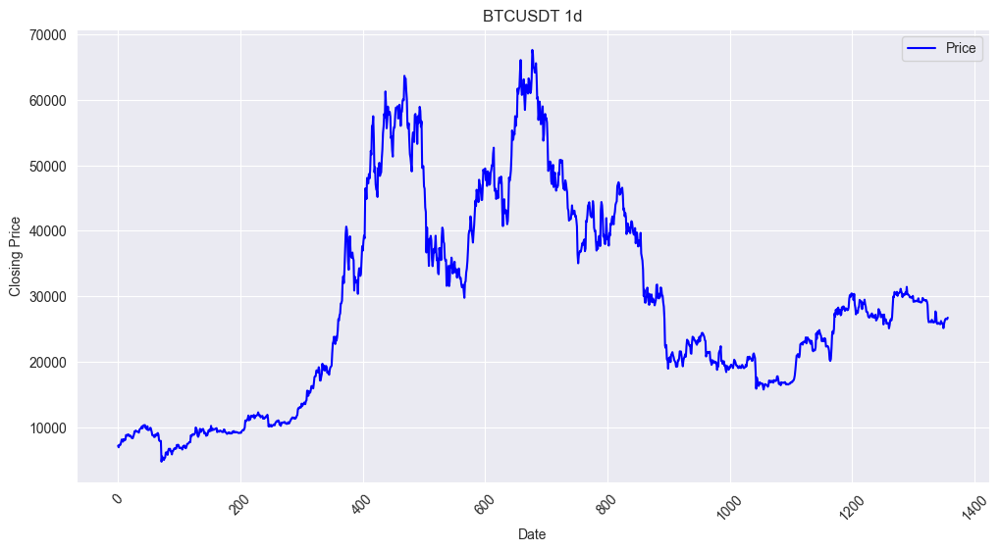

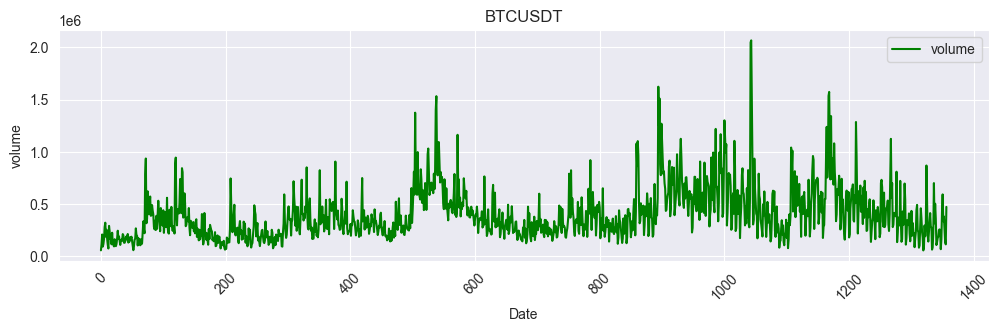

In [175]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# Loading data from a CSV file
day_k = pd.read_csv('/Users/frank/Downloads/BTCUSDT永續1d_2_4_2021_to_9_19_2023.csv')
day_k = day_k.iloc[: , 1:]
plt.figure(figsize=(12, 6))
sns.set_style("darkgrid")

# Customize the chart
plt.title("BTCUSDT 1d")
plt.xlabel("Date")
plt.ylabel("Closing Price")

# Plot the data
plt.plot( day_k['close'], label='Price', color='blue')

# Add legend
plt.legend()

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Show the chart
plt.show()

plt.figure(figsize=(12, 3))
sns.set_style("darkgrid")

# Customize the chart
plt.title("BTCUSDT")
plt.xlabel("Date")
plt.ylabel("volume")

# Plot the data
plt.plot( day_k['volume'], label='volume', color='green')

# Add legend
plt.legend()

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Show the chart
plt.show()


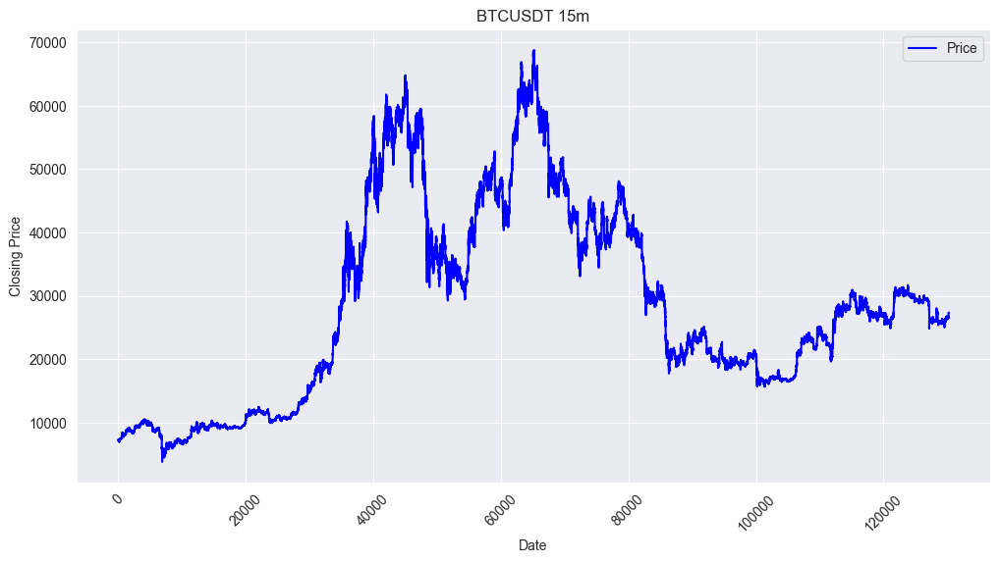

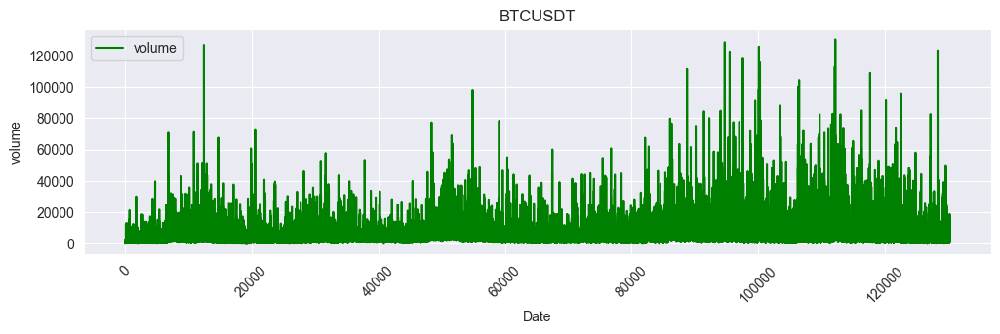

In [138]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# Loading data from a CSV file
df = pd.read_csv('/Users/frank/Downloads/BTCUSDT永續15m_2_4_2021_to_9_19_2023.csv')
df = df.iloc[: , 1:]
plt.figure(figsize=(12, 6))
sns.set_style("darkgrid")

# Customize the chart
plt.title("BTCUSDT 15m")
plt.xlabel("Date")
plt.ylabel("Closing Price")

# Plot the data
plt.plot( df['close'], label='Price', color='blue')

# Add legend
plt.legend()

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Show the chart
plt.show()

plt.figure(figsize=(12, 3))
sns.set_style("darkgrid")

# Customize the chart
plt.title("BTCUSDT")
plt.xlabel("Date")
plt.ylabel("volume")

# Plot the data
plt.plot( df['volume'], label='volume', color='green')

# Add legend
plt.legend()

# Rotate x-axis labels for readability
plt.xticks(rotation=45)

# Show the chart
plt.show()


Week analysis

In [177]:
count = 0
for i in range(len(day_k)):
    day_k.iloc[i,6] = week[count%7]
    count+=1
#計算個星期交易量加總
week_volume ={"Monday": 0, "Tuesday": 0, "Wednesday": 0, "Thursday": 0, "Friday": 0, "Saturday": 0, "Sunday": 0}
for i in range(len(day_k['week'])):
    if day_k.iloc[i,6]=="Monday":
        week_volume["Monday"] += day_k.iloc[i,5]
    elif day_k.iloc[i,6]=="Tuesday":
        week_volume["Tuesday"] += day_k.iloc[i,5]
    elif day_k.iloc[i,6]=="Wednesday":
        week_volume["Wednesday"] += day_k.iloc[i,5]
    elif day_k.iloc[i,6]=="Thursday":
        week_volume["Thursday"] += day_k.iloc[i,5]
    elif day_k.iloc[i,6]=="Friday":
        week_volume["Friday"] += day_k.iloc[i,5]
    elif day_k.iloc[i,6]=="Saturday":
        week_volume["Saturday"] += day_k.iloc[i,5]
    else:
        week_volume["Sunday"] += day_k.iloc[i,5]
#計算平均交易量
week_volume['Monday'] = round(week_volume['Monday']/193, 2)
week_volume['Tuesday'] = round(week_volume['Tuesday']/193,2)
week_volume['Wednesday'] = round(week_volume['Wednesday']/193, 2)
week_volume['Thursday'] = round(week_volume['Thursday']/194, 2)
week_volume['Friday'] = round(week_volume['Friday']/194, 2)
week_volume['Saturday'] = round(week_volume['Saturday']/194, 2)
week_volume['Sunday'] = round(week_volume['Sunday']/194, 2)
print(week_volume)

{'Monday': 444475.27, 'Tuesday': 442329.23, 'Wednesday': 465084.33, 'Thursday': 449745.7, 'Friday': 433339.43, 'Saturday': 275868.02, 'Sunday': 296669.01}


In [178]:
#volatility 計算
#當前最高價減去當前最低價=(high-close)/open 避免用點數會失真
day_volatility = []
day_volatility = (day_k.loc[:, 'high'] - day_k.loc[:, 'low'])/day_k.loc[:, 'open']
#print(day_volatility)
day_k['volatility'] = day_volatility
#print(day_k.to_string())

week_volatility ={"Monday": 0, "Tuesday": 0, "Wednesday": 0, "Thursday": 0, "Friday": 0, "Saturday": 0, "Sunday": 0}
for i in range(len(day_k['week'])):
    if day_k.iloc[i,6]=="Monday":
        week_volatility["Monday"] += day_k.iloc[i,7]
    elif day_k.iloc[i,6]=="Tuesday":
        week_volatility["Tuesday"] += day_k.iloc[i,7]
    elif day_k.iloc[i,6]=="Wednesday":
        week_volatility["Wednesday"] += day_k.iloc[i,7]
    elif day_k.iloc[i,6]=="Thursday":
        week_volatility["Thursday"] += day_k.iloc[i,7]
    elif day_k.iloc[i,6]=="Friday":
        week_volatility["Friday"] += day_k.iloc[i,7]
    elif day_k.iloc[i,6]=="Saturday":
        week_volatility["Saturday"] += day_k.iloc[i,7]
    else:
        week_volatility["Sunday"] += day_k.iloc[i,7]
week_volatility['Monday'] = week_volatility['Monday']*100/193
week_volatility['Tuesday'] = week_volatility['Tuesday']*100/193
week_volatility['Wednesday'] = week_volatility['Wednesday']*100/193
week_volatility['Thursday'] = week_volatility['Thursday']*100/194
week_volatility['Friday'] = week_volatility['Friday']*100/194
week_volatility['Saturday'] = week_volatility['Saturday']*100/194
week_volatility['Sunday'] = week_volatility['Sunday']*100/194
print(week_volatility)

{'Monday': 6.103480290685238, 'Tuesday': 5.246502139485469, 'Wednesday': 5.847378157719092, 'Thursday': 5.8459376952473905, 'Friday': 5.654127297666059, 'Saturday': 3.7078001977769337, 'Sunday': 4.397300629588455}


長條圖與折線圖函式

In [229]:
import numpy as np
def plot_bar_line_chart(title, xlabel, ylabel, ylabel2, categories, bar_values, line_values):
    # Create a figure and axis
    fig, ax = plt.subplots()
    # Create the bar chart
    bars = ax.bar(categories, bar_values, color='skyblue', label='volume')

    # Create the line plot
    x = np.arange(len(categories))
    ax2 = ax.twinx()
    ax2.plot(x, line_values, marker='o', color='orange', label='volatility')

    # Customize the appearance
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax2.set_ylabel(ylabel2)

    # Add data labels above the bars
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height}',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords='offset points',
                    ha='center', va='bottom')

    # Add legend
    ax.legend(loc='lower left')
    ax2.legend(loc='lower right')

    # Adjust the layout
    fig.tight_layout()

    # Show the chart
    plt.show()

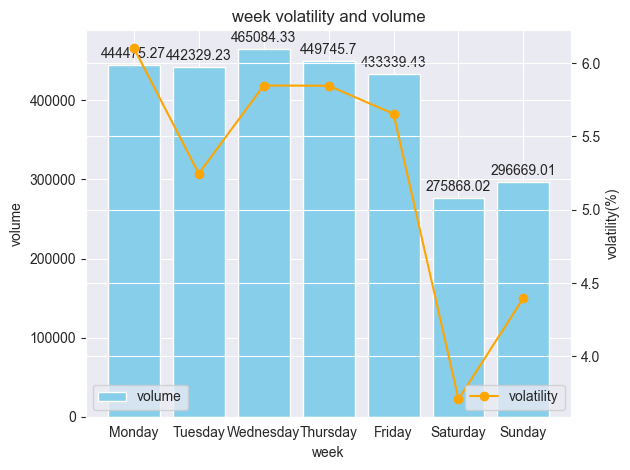

In [180]:
title = 'week volatility and volume'
xlabel = 'week'
ylabel = 'volume'
ylabel2 = 'volatility(%)'
plot_bar_line_chart(title, xlabel, ylabel, ylabel2, list(week_volume.keys()), list(week_volume.values()), list(week_volatility.values()))


248221.16175293812
442184.16337628866
270361.46706565935
442329.23169430054
278899.6738845594
462686.9899896907
238466.82081150633
449745.7027474227
239007.56109392035
433339.4314278351
184700.6228690234
275868.02017525776
169787.88362716706
296669.0083402062


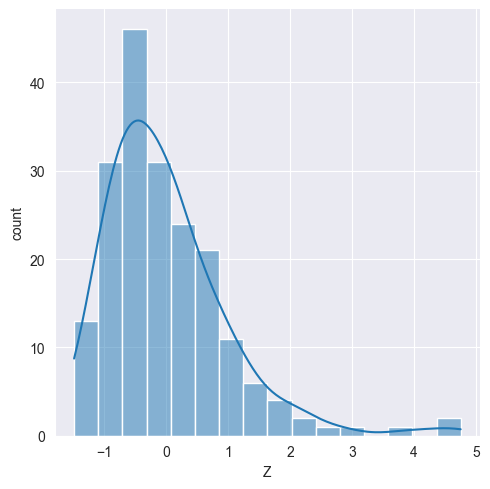

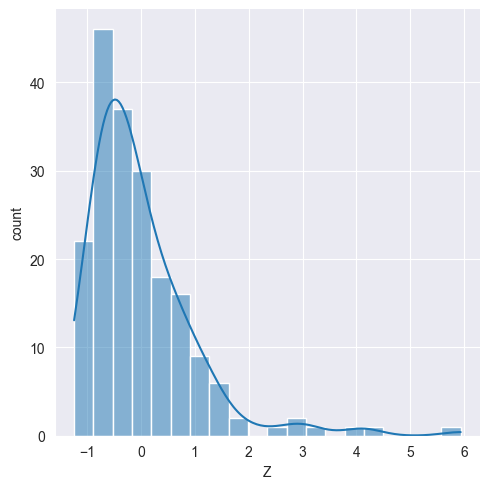

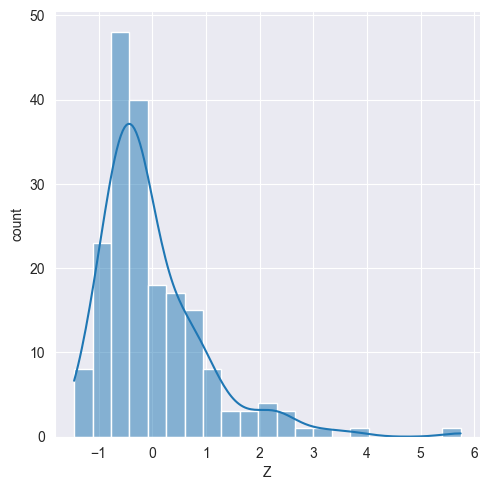

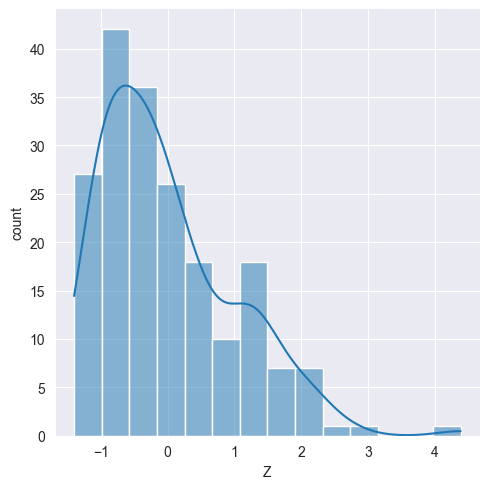

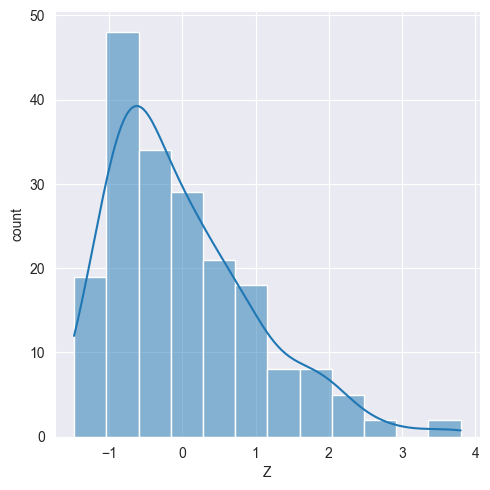

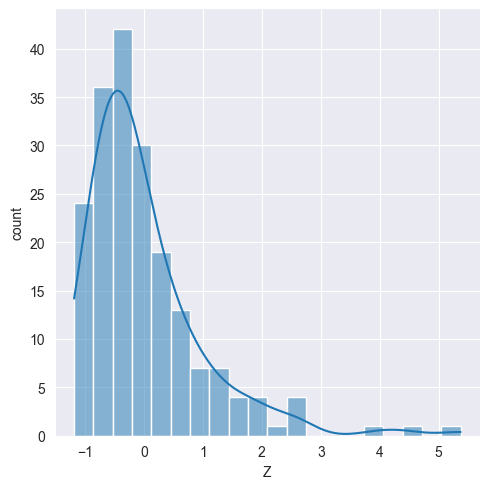

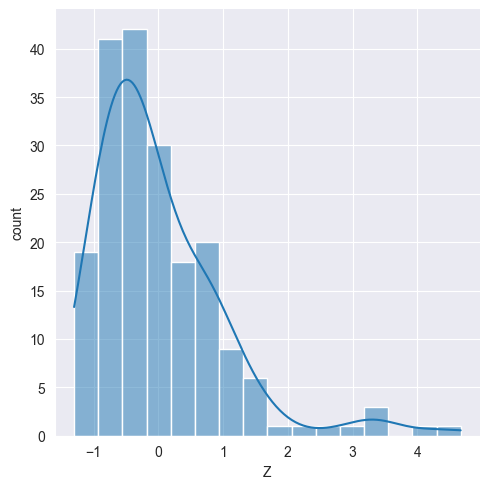

In [260]:
from statistics import stdev, mean, variance
def distrbution_plot(week):
    Mon_vol = day_k.loc[day_k["week"]==week, "volume"]
    vol_std= stdev(Mon_vol)
    print(vol_std)
    vol_mean = mean(Mon_vol)
    print(vol_mean)
    Mon_vol = (Mon_vol-vol_mean)/vol_std
    plot = sns.displot(Mon_vol, kde=True)
    plot.set_titles("distribution of "+week+" volume")
    plot.set_axis_labels("Z", "count")

distrbution_plot("Monday")
distrbution_plot("Tuesday")
distrbution_plot("Wednesday")
distrbution_plot("Thursday")
distrbution_plot("Friday")
distrbution_plot("Saturday")
distrbution_plot("Sunday")


In [ ]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1)
mean, var, skew, kurt = norm.stats(moments='mvsk')
x = np.linspace(norm.ppf(0.01),
                norm.ppf(0.99), 100)
ax.plot(x, norm.pdf(x),
       'r-', lw=5, alpha=0.6, label='norm pdf')

In [181]:
#各種交易時期計算交易量
trading_time_volume ={"open": 0, "close": 0, "trading": 0, "sleep": 0}
open = 0
close = 0
trading = 0
sleep = 0
for i in range(len(df['US_stock'])):
    if df.iloc[i,7]=="open":
        trading_time_volume["open"] += df.iloc[i,5]
        open+=1
    elif df.iloc[i,7]=="close":
        trading_time_volume["close"] += df.iloc[i,5]
        close+=1
    elif df.iloc[i,7]=="trading":
        trading_time_volume["trading"] += df.iloc[i,5]
        trading+=1
    else:
        trading_time_volume["sleep"] += df.iloc[i,5]
        sleep+=1
print(trading_time_volume)
trading_time_volume["open"] = round(trading_time_volume["open"]/open, 2)
trading_time_volume["close"] = round(trading_time_volume["close"]/close, 2)
trading_time_volume["trading"] = round(trading_time_volume["trading"]/trading, 2)
trading_time_volume["sleep"] = round(trading_time_volume["sleep"]/sleep, 2)
print(trading_time_volume)

{'open': 10116957.712000018, 'close': 6256677.115000008, 'trading': 181915600.88799852, 'sleep': 344844695.6240032}
{'open': 7455.39, 'close': 4614.07, 'trading': 5364.66, 'sleep': 3684.32}


In [182]:
#volatility 計算
#當前最高價減去當前最低價=(high-close)/open 避免用點數會失真
volatility_15m = []
volatility_15m = (df.loc[:, 'high'] - df.loc[:, 'low'])/df.loc[:, 'open']
#print(day_volatility)
df['volatility'] = volatility_15m
trading_time_volatility ={"open": 0, "close": 0, "trading": 0, "sleep": 0}
open = 0
close = 0
trading = 0
sleep = 0
for i in range(len(df['US_stock'])):
    if df.iloc[i,7]=="open":
        trading_time_volatility["open"] += df.iloc[i,8]
        open+=1
    elif df.iloc[i,7]=="close":
        trading_time_volatility["close"] += df.iloc[i,8]
        close+=1
    elif df.iloc[i,7]=="trading":
        trading_time_volatility["trading"] += df.iloc[i,8]
        trading+=1
    else:
        trading_time_volatility["sleep"] += df.iloc[i,8]
        sleep+=1
print(trading_time_volatility)
trading_time_volatility["open"] = round(trading_time_volatility["open"]*100/open, 2)
trading_time_volatility["close"] = round(trading_time_volatility["close"]*100/close, 2)
trading_time_volatility["trading"] = round(trading_time_volatility["trading"]*100/trading, 2)
trading_time_volatility["sleep"] = round(trading_time_volatility["sleep"]*100/sleep, 2)
print(trading_time_volatility)

{'open': 9.187282531348703, 'close': 7.467612302599542, 'trading': 182.54205689767284, 'sleep': 432.5581546095127}
{'open': 0.68, 'close': 0.55, 'trading': 0.54, 'sleep': 0.46}


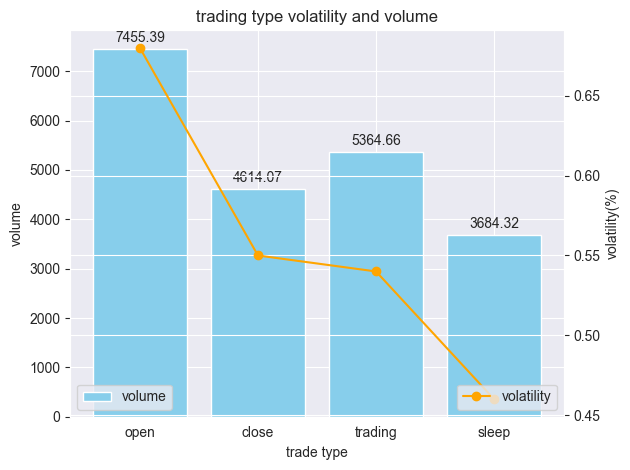

In [254]:
title = 'trading type volatility and volume'
xlabel = 'trade type'
ylabel = 'volume'
ylabel2 = 'volatility(%)'
plot_bar_line_chart(title, xlabel, ylabel, ylabel2, list(trading_time_volume.keys()), list(trading_time_volume.values()), list(trading_time_volatility.values()))

In [186]:
year_average_volume ={"2020": 0, "2021": 0, "2022": 0, "2023": 0}
count_2020 = 0
count_2021 = 0
count_2022 = 0
count_2023 = 0
for i in range(len(day_k['time'])):
    if "2020" in str(day_k.iloc[i,0]):
        year_average_volume["2020"] += day_k.iloc[i,5]
        count_2020+=1
    elif "2021" in str(day_k.iloc[i,0]):
        year_average_volume["2021"] += day_k.iloc[i,5]
        count_2021+=1
    elif "2022" in str(day_k.iloc[i,0]):
        year_average_volume["2022"] += day_k.iloc[i,5]
        count_2022+=1
    else:
        year_average_volume["2023"] += day_k.iloc[i,5]
        count_2023+=1
print(year_average_volume)
year_average_volume["2020"] = round(year_average_volume["2020"]/count_2020, 2)
year_average_volume["2021"] = round(year_average_volume["2021"]/count_2021, 2)
year_average_volume["2022"] = round(year_average_volume["2022"]/count_2022, 2)
year_average_volume["2023"] = round(year_average_volume["2023"]/count_2023, 2)
print(year_average_volume)

{'2020': 99734900.20899996, '2021': 144753730.90900007, '2022': 180584203.435, '2023': 118232410.47899996}
{'2020': 272499.73, '2021': 396585.56, '2022': 494751.24, '2023': 452997.74}


In [191]:

year_average_volatility ={"2020": 0, "2021": 0, "2022": 0, "2023": 0}
count_2020 = 0
count_2021 = 0
count_2022 = 0
count_2023 = 0
for i in range(len(day_k['time'])):
    if "2020" in str(day_k.iloc[i,0]):
        year_average_volatility["2020"] += day_k.iloc[i,7]
        count_2020+=1
    elif "2021" in str(day_k.iloc[i,0]):
        year_average_volatility["2021"] += day_k.iloc[i,7]
        count_2021+=1
    elif "2022" in str(day_k.iloc[i,0]):
        year_average_volatility["2022"] += day_k.iloc[i,7]
        count_2022+=1
    else:
        year_average_volatility["2023"] += day_k.iloc[i,7]
        count_2023+=1
print(year_average_volatility)
year_average_volatility["2020"] = round(year_average_volatility["2020"]*100/count_2020, 2)
year_average_volatility["2021"] = round(year_average_volatility["2021"]*100/count_2021, 2)
year_average_volatility["2022"] = round(year_average_volatility["2022"]*100/count_2022, 2)
year_average_volatility["2023"] = round(year_average_volatility["2023"]*100/count_2023, 2)
print(year_average_volatility)

{'2020': 18.842920973376195, '2021': 25.64693685000654, '2022': 17.74042977860346, '2023': 8.994640023982047}
{'2020': 5.15, '2021': 7.03, '2022': 4.86, '2023': 3.45}


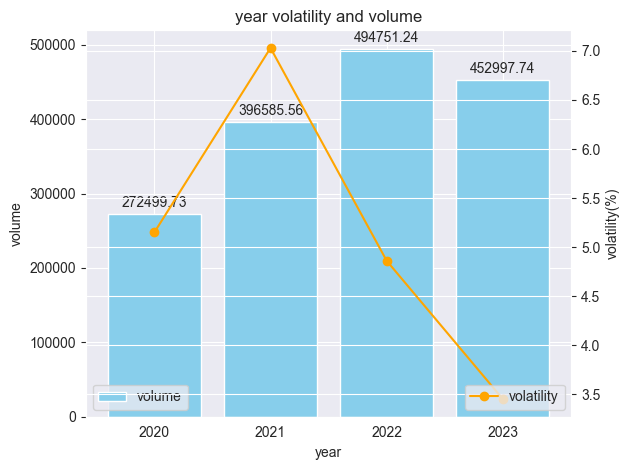

In [192]:
title = 'year volatility and volume'
xlabel = 'year'
ylabel = 'volume'
ylabel2 = 'volatility(%)'
plot_bar_line_chart(title, xlabel, ylabel, ylabel2, list(year_average_volume.keys()), list(year_average_volume.values()), list(year_average_volatility.values()))

In [235]:
#計算各月平均交易量
month_volume ={"January": 0, "February": 0, "March": 0, "April": 0, "May": 0, "June": 0, "July": 0, "August": 0, "September": 0, "October": 0, "November": 0, "December": 0}
count=[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0] #計算每月有幾天
for i in range(len(day_k['time'])):
    if "-01-" in str(day_k.iloc[i,0]):
        month_volume["January"] += day_k.iloc[i,5]
        count[0]+=1
    elif "-02-" in str(day_k.iloc[i,0]):
        month_volume["February"] += day_k.iloc[i,5]
        count[1]+=1
    elif "-03-" in str(day_k.iloc[i,0]):
        month_volume["March"] += day_k.iloc[i,5]
        count[2]+=1
    elif "-04-" in str(day_k.iloc[i,0]):
        month_volume["April"] += day_k.iloc[i,5]
        count[3]+=1
    elif "-05-" in str(day_k.iloc[i,0]):
        month_volume["May"] += day_k.iloc[i,5]
        count[4]+=1
    elif "-06-" in str(day_k.iloc[i,0]):
        month_volume["June"] += day_k.iloc[i,5]
        count[5]+=1
    elif "-07-" in str(day_k.iloc[i,0]):
        month_volume["July"] += day_k.iloc[i,5]
        count[6]+=1
    elif "-08-" in str(day_k.iloc[i,0]):
        month_volume["August"] += day_k.iloc[i,5]
        count[7]+=1
    elif "-09-" in str(day_k.iloc[i,0]):
        month_volume["September"] += day_k.iloc[i,5]
        count[8]+=1
    elif "-10-" in str(day_k.iloc[i,0]):
        month_volume["October"] += day_k.iloc[i,5]
        count[9]+=1
    elif "-11-" in str(day_k.iloc[i,0]):
        month_volume["November"] += day_k.iloc[i,5]
        count[10]+=1
    else:
        month_volume["December"] += day_k.iloc[i,5]
        count[11]+=1
#計算平均交易量
month_volume['January'] = round(month_volume['January']/count[0])
month_volume['February'] = round(month_volume['February']/count[1])
month_volume['March'] = round(month_volume['March']/count[2])
month_volume['April'] = round(month_volume['April']/count[3])
month_volume['May'] = round(month_volume['May']/count[4])
month_volume['June'] = round(month_volume['June']/count[5])
month_volume['July'] = round(month_volume['July']/count[6])
month_volume['August'] = round(month_volume['August']/count[7])
month_volume['September'] = round(month_volume['September']/count[8])
month_volume['October'] = round(month_volume['October']/count[9])
month_volume['November'] = round(month_volume['November']/count[10])
month_volume['December'] = round(month_volume['December']/count[11])
print(month_volume)

{'January': 349628, 'February': 347804, 'March': 436262, 'April': 352411, 'May': 460100, 'June': 541406, 'July': 422998, 'August': 377406, 'September': 405343, 'October': 356355, 'November': 421115, 'December': 302948}


In [194]:
print(day_k)

                     time      open      high       low     close      volume  \
0     2020-01-01 08:00:00   7189.43   7260.43   7170.15   7197.57   56801.329   
1     2020-01-02 08:00:00   7197.57   7209.59   6922.00   6962.04  115295.677   
2     2020-01-03 08:00:00   6962.34   7407.28   6863.44   7341.72  208493.458   
3     2020-01-04 08:00:00   7341.60   7400.00   7269.21   7350.71   92586.033   
4     2020-01-05 08:00:00   7350.54   7495.00   7303.00   7354.36  117765.972   
...                   ...       ...       ...       ...       ...         ...   
1352  2023-09-14 08:00:00  26209.90  26880.00  26106.60  26510.30  380666.471   
1353  2023-09-15 08:00:00  26510.30  26890.00  26206.60  26591.10  251656.770   
1354  2023-09-16 08:00:00  26591.10  26763.50  26430.00  26546.90  140482.465   
1355  2023-09-17 08:00:00  26547.00  26614.30  26377.40  26514.20  114239.394   
1356  2023-09-18 08:00:00  26514.20  27397.00  26358.60  26749.90  472539.032   

           week  volatility

In [198]:
#計算各月平均波動度
month_volatility ={"January": 0, "February": 0, "March": 0, "April": 0, "May": 0, "June": 0, "July": 0, "August": 0, "September": 0, "October": 0, "November": 0, "December": 0}
count=[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0] #計算每月有幾天
for i in range(len(day_k['time'])):
    if "-01-" in str(day_k.iloc[i,0]):
        month_volatility["January"] += day_k.iloc[i,7]
        count[0]+=1
    elif "-02-" in str(day_k.iloc[i,0]):
        month_volatility["February"] += day_k.iloc[i,7]
        count[1]+=1
    elif "-03-" in str(day_k.iloc[i,0]):
        month_volatility["March"] += day_k.iloc[i,7]
        count[2]+=1
    elif "-04-" in str(day_k.iloc[i,0]):
        month_volatility["April"] += day_k.iloc[i,7]
        count[3]+=1
    elif "-05-" in str(day_k.iloc[i,0]):
        month_volatility["May"] += day_k.iloc[i,7]
        count[4]+=1
    elif "-06-" in str(day_k.iloc[i,0]):
        month_volatility["June"] += day_k.iloc[i,7]
        count[5]+=1
    elif "-07-" in str(day_k.iloc[i,0]):
        month_volatility["July"] += day_k.iloc[i,7]
        count[6]+=1
    elif "-08-" in str(day_k.iloc[i,0]):
        month_volatility["August"] += day_k.iloc[i,7]
        count[7]+=1
    elif "-09-" in str(day_k.iloc[i,0]):
        month_volatility["September"] += day_k.iloc[i,7]
        count[8]+=1
    elif "-10-" in str(day_k.iloc[i,0]):
        month_volatility["October"] += day_k.iloc[i,7]
        count[9]+=1
    elif "-11-" in str(day_k.iloc[i,0]):
        month_volatility["November"] += day_k.iloc[i,7]
        count[10]+=1
    else:
        month_volatility["December"] += day_k.iloc[i,7]
        count[11]+=1
#計算平均交易量
month_volatility['January'] = round(month_volatility['January']*100/count[0], 2)
month_volatility['February'] = round(month_volatility['February']*100/count[1], 2)
month_volatility['March'] = round(month_volatility['March']*100/count[2], 2)
month_volatility['April'] = round(month_volatility['April']*100/count[3], 2)
month_volatility['May'] = round(month_volatility['May']*100/count[4], 2)
month_volatility['June'] = round(month_volatility['June']*100/count[5], 2)
month_volatility['July'] = round(month_volatility['July']*100/count[6], 2)
month_volatility['August'] = round(month_volatility['August']*100/count[7], 2)
month_volatility['September'] = round(month_volatility['September']*100/count[8], 2)
month_volatility['October'] = round(month_volatility['October']*100/count[9], 2)
month_volatility['November'] = round(month_volatility['November']*100/count[10], 2)
month_volatility['December'] = round(month_volatility['December']*100/count[11], 2)
print(month_volatility)

{'January': 6.04, 'February': 5.68, 'March': 6.96, 'April': 4.81, 'May': 6.41, 'June': 5.67, 'July': 4.28, 'August': 4.07, 'September': 4.56, 'October': 4.09, 'November': 5.25, 'December': 4.67}


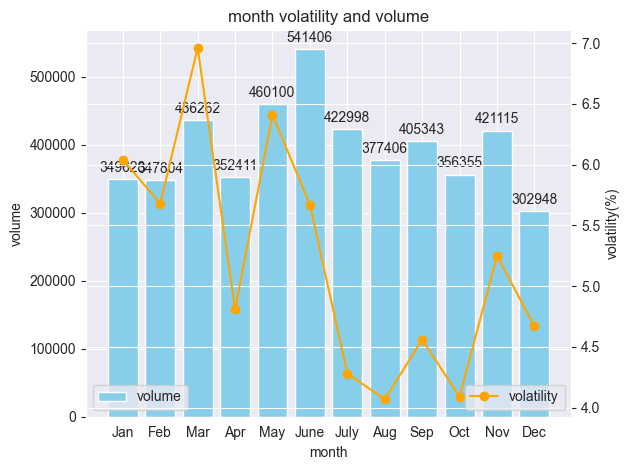

In [236]:
title = 'month volatility and volume'
xlabel = 'month'
ylabel = 'volume'
ylabel2 = 'volatility(%)'
plot_bar_line_chart(title, xlabel, ylabel, ylabel2, ["Jan", "Feb", "Mar", "Apr", "May", "June", "July", "Aug", "Sep", "Oct", "Nov", "Dec"], list(month_volume.values()), list(month_volatility.values()))

In [281]:
#討論交易量與波動度相關性
import numpy as np
year_volume_and_volatility_correlation = np.corrcoef(np.array(list(year_average_volume.values())),np.array(list(year_average_volatility.values())))
month_volume_and_volatility_correlation = np.corrcoef(np.array(list(month_volatility.values())),np.array(list(month_volume.values())))
trading_time_volume_and_volatility_correlation = np.corrcoef(np.array(list(trading_time_volume.values())),np.array(list(trading_time_volatility.values())))
week_volume_and_volatility_correlation = np.corrcoef(np.array(list(week_volume.values())),np.array(list(week_volatility.values())))
print("year: "+str(year_volume_and_volatility_correlation[0, 1]))
print("month: "+str(month_volume_and_volatility_correlation[0, 1]))
print("trading_time: "+str(trading_time_volume_and_volatility_correlation[0, 1]))
print("week: "+str(week_volume_and_volatility_correlation[0, 1]))

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
